# 🐍 Les Bibliothèques

---

## 📌 1. Qu’est-ce qu’une bibliothèque ?

Une bibliothèque Python est un ensemble de fonctions, classes et outils déjà créés par d’autres personnes, que tu peux réutiliser facilement dans tes projets.

## 📌 2. Comment utiliser une bibliothèque ?

On commence par l’importer dans le code :

In [ ]:
import math  # Pour les fonctions mathématiques
import random  # Pour générer de l'aléatoire

Pour certaines bibliothèques externes (comme matplotlib, numpy, etc.), il faut parfois les installer via pip :

    pip install matplotlib

Et ensuite :

In [ ]:
import matplotlib.pyplot as plt

## 📌 3. Bibliothèques courantes

|    Bibliothèque     |   Utilité  |
|------------------|------------------|
| math | Calculs mathématiques |
| random | Génération de nombres aléatoires |
| matplotlib | Tracer des graphiques |
| numpy | Manipulation de données |
| pandas | Travailler avec des tableaux |

---

L'UGA-25 arrive bientôt à destination, plus que le champs d'astéroide à franchir et nous serons arrivés à destination !

En parlant d'asteroide, en voila un qui fonce droit vers nous d'après le radar !

Lance le programme et appuye sur les boutons à disposition pour manipuler l'animation comme tu le souhaites et déterminer si nous sommes en danger.

In [90]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Données de la trajectoire
x = np.linspace(0, 10, 200)
y = -0.5 * (x - 5)**2 + 12

# Coordonnées du vaisseau
vx, vy = 5, 9.5

# Préparation du graphique
fig, ax = plt.subplots()
line, = ax.plot([], [], 'r-', lw=2, label="Trajectoire météorite")
ship_point = ax.plot(vx, vy, 'bo', label="Vaisseau")[0]
ax.set_xlim(0, 10)
ax.set_ylim(0, 13)
ax.set_title("Trajectoire de la météorite vs Vaisseau")
ax.set_xlabel("Position X")
ax.set_ylabel("Position Y")
ax.legend()

# Initialisation
def init():
    line.set_data([], [])
    return line, ship_point

# Mise à jour à chaque frame
def update(frame):
    line.set_data(x[:frame], y[:frame])
    return line, ship_point

# Animation
ani = FuncAnimation(fig, update, frames=len(x), init_func=init, blit=True, interval=20)
plt.close(fig)

# Affichage
HTML(ani.to_jshtml())

Nous avons évité le premier obstacle mais traverser le champs d'asteroides peut nous prendre du temps... Faisons un récapitulatif de nos ressources et affichons les à l'aide d'un historgamme pour mieux les visualiser !

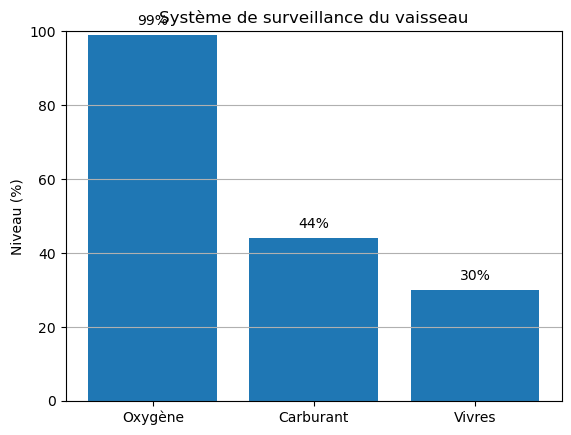

In [ ]:
ressources = ["Oxygène", "Carburant", "Vivres"]
niveaux = [int(input("Oxygène ? ")), int(input("Carburant ? ")), 30]

# Construit le graphique en donnant le nom des donnees que tu veux afficher puis leurs valeurs
plt.bar(..., ...) # on peut rajouter color=['red', 'blue', 'green'] pour colorier chaque barre

# Customisation du graphique
plt.title("Système de surveillance du vaisseau") # titre du graphique
plt.ylabel("Niveau (%)") # titre axe y
plt.ylim(0, 100) # graduation axe y
plt.grid(axis='y') # lignes de graduation sur y

for i, val in enumerate(niveaux):
    plt.text(i, val + 2, f"{val}%", ha='center', va='bottom', color='black') # pour afficher les pourcentages

Nous voilà maintenant en plein dans le champ d'astéroides, lançons la simulation avec les données du radar pour déterminer si nous allons rentrer en collision et ainsi prévenir l'équipage pour que l'on modifie notre trajectoire !

Les trajectoires sont très aléatoires alors n'hésite pas à relancer plusieurs fois le simulateur.

In [103]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Données
x = np.linspace(0, 10, 200)
vx, vy = 5, 9.5
tolerance = float(input("Quelle marge de tolérance pour déterminer la collision (en km) ?"))  # Zone de collision

# Génération aléatoire des trajectoires
np.random.seed(None)
trajectoires = []
for _ in range(5):
    a = -0.2 * np.random.rand() - 0.05
    b = np.random.uniform(2, 8)
    c = np.random.uniform(5, 14)
    y = a * (x - b)**2 + c
    trajectoires.append(y)

# Préparation du graphique
fig, ax = plt.subplots()
lines = [ax.plot([], [], lw=2)[0] for _ in range(5)]
ship = ax.plot(vx, vy, 'bo')[0]
danger_text = ax.text(5, 13, '', fontsize=30, color='red', ha='center', weight='bold')

ax.set_xlim(0, 10)
ax.set_ylim(0, 14)
ax.set_title("Trajectoires des astéroïdes")
ax.set_xlabel("X")
ax.set_ylabel("Y")

# Init
def init():
    for line in lines:
        line.set_data([], [])
    danger_text.set_text('')
    return lines + [ship, danger_text]

# Update à chaque frame
def update(frame):
    danger = False
    for i, line in enumerate(lines):
        x_vals = x[:frame]
        y_vals = trajectoires[i][:frame]
        line.set_data(x_vals, y_vals)

        # Check collision à chaque point affiché
        for j in range(len(x_vals)):
            dx = x_vals[j] - vx
            dy = y_vals[j] - vy
            if np.sqrt(dx**2 + dy**2) < tolerance:
                danger = True
                break  # Pas besoin de continuer si danger détecté

    danger_text.set_text('DANGER' if danger else '')
    return lines + [ship, danger_text]

ani = FuncAnimation(fig, update, frames=len(x), init_func=init, blit=True, interval=20)
plt.close(fig)
HTML(ani.to_jshtml())

Alors que vous venez de sortir du champs d'astéroides le système vous transmet cette enregistrement de fréquence intercepté d'un endroit inconnu... Lancez le programme pour le visualiser.

In [109]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Génération des données
x = np.linspace(0, 20, 100)
y = np.random.normal(0, 1, 100)
y[25] += 8
y[40] += 7.5
y[65] += 10 
y[90] += 6.5 # Ajout d'un pic pour simuler un signal anormal

# Préparation du graphique
fig, ax = plt.subplots()
line, = ax.plot([], [], lw=2, label="Signaux reçus")
ax.axhline(5, color='red', linestyle='--', label="Seuil d'alerte")

ax.set_xlim(0, 20)
ax.set_ylim(min(y)-1, max(y)+1)
ax.set_title("Analyse de l'espace : Anomalie détectée")
ax.set_xlabel("Fréquence")
ax.set_ylabel("Amplitude")
ax.legend()

# Initialisation
def init():
    line.set_data([], [])
    return line,

# Mise à jour
def update(frame):
    line.set_data(x[:frame], y[:frame])
    return line,

# Animation
ani = FuncAnimation(fig, update, frames=len(x), init_func=init, blit=True, interval=50)
plt.close(fig)

# Affichage
HTML(ani.to_jshtml())